
# Week 5 - Discovering Patterns: Clusters & Topics

This week, we seek to seek to discover patterns in our text data. First, we take a text corpus that we have developed and discovery emergent clusters through a process known as clustering or partitioning. We pilot this here both with a well-known *flat* clustering method, `kmeans`, and also a *hierarchical* approach, `Ward's (minimum variance) method`. We will demonstrate a simple (graphical) approach to identifying optimal cluster number, the sillhouette method, and evaluate the quality of unsupervised clusters on labeled data. Next, we will explore a method of two dimensional content clustering called topic modeling (e.g., words cluster in topics; topics cluster in documents). This statistical technique models and computationally induces *topics* from data, which are sparse distributions over (nonexclusive clusters of) words, from which documents can formally be described as sparse mixtures. We will explore these topics and consider their utility for understanding trends within a corpus. We will consider how to construct models that take document cluster and topic loadings as predictive features, the basis of influence metrics and dynamically over time.

For this notebook we will be using the following packages:

## <span style="color:red">*Pitch Your Project*</span>

<span style="color:red">In the three cells immediately following, describe **WHAT** you are planning to analyze for your final project (i.e., texts, contexts and the social game, world and actors you intend to learn about through your analysis) (<200 words), **WHY** you are going to do it (i.e., why would theory and/or the average person benefit from knowing the results of your investigation) (<200 words), and **HOW** you plan to investigate it (i.e., what are the approaches and operations you plan to perform, in sequence, to yield this insight) (<400 words).


# ***What?***     

        For the final project, I intend to use the PubMed abtract data. Specifically, I plan to model the paradigm shifts across the years for popular psychology topics. Topic modeling and clustering would be mainly used as unsupervised ways of extracting patterns over time. If a clear trend is observed, this could be instrumental in predicting future psychology paper topics.
        

## ***Why?***
        First, the meaning of this project lies within the generalizability of the methods. Essentially, trends for any field could be extracted. Also, the project can shed light on the research direction of psychology, so psychologists can choose to work on/avoid popular topics of the year. 
        

     
     
## ***How?***
        PubMed abstracts would be extracted using large-scale computing techniques. When the data are ready, the methods of this assignment will be used, combining with some network analysis.
        
        
    
     
## <span style="color:red">*Pitch Your Sample*</span>

<span style="color:red">In the cell immediately following, describe the rationale behind your proposed sample design for your final project. What is the social game, social work, or social actors you about whom you are seeking to make inferences? What are its virtues with respect to your research questions? What are its limitations? What are alternatives? What would be a reasonable path to "scale up" your sample for further analysis (i.e., high-profile publication) beyond this class? (<300 words).


## ***Which (words)?***
<300 words
        
        As mentioned in the Why section, the rationale of this project is to obtain a bigger picture in order for psychologists to understand the paradigms of past psychology research topics up until now. Topic modeling and clustering methods can serve as as a smart 'filter' machine for literature reviews for researchers. For example, by performing network analysis on pharmaceutical research, we will be able to see the most interested areas, and so researchers can pull their resources together to make collective progress in a specific field (e.g. trying to conquer Alzheimer). 
        
        The challenges of this research mostly come from the hyperparameter tuning part, since the methods are mostly unsupervised. Data extraction and cleaning will be crucial too.
    


# Discovering Patterns: Clusters & Topics  
# On Netflix Data  

The goal of this project is to discover meaningful patterns in text data. We used mostly unsupervised learning models, including K-means, silhouette method, ward’s method and LDA.  

In [4]:
#Special module written for this class
#This provides access to data and to helper functions from previous weeks
#Make sure you update it before starting this notebook
import lucem_illud_2020 #pip install -U git+git://github.com/Computational-Content-Analysis-2020/lucem_illud_2020.git


#All these packages need to be installed from pip
#These are all for the cluster detection
import sklearn
import sklearn.feature_extraction.text
import sklearn.pipeline
import sklearn.preprocessing
import sklearn.datasets
import sklearn.cluster
import sklearn.decomposition
import sklearn.metrics

import scipy #For hierarchical clustering and some visuals
#import scipy.cluster.hierarchy
import gensim#For topic modeling
import requests #For downloading our datasets
import numpy as np #for arrays
import pandas #gives us DataFrames
import matplotlib.pyplot as plt #For graphics
import matplotlib.cm #Still for graphics
import seaborn as sns #Makes the graphics look nicer

#This 'magic' command makes the plots work better
#in the notebook, don't use it outside of a notebook.
#Also you can ignore the warning, it
%matplotlib inline

import itertools
import json

### First let's take a look at the data set.  
### The data set contains 6,234 TV shows and movies on Netflix. This data is readily available on Kaggle (https://www.kaggle.com/shivamb/netflix-shows). I used the description column as the text data. The column listed_in represents the genres which the movies are in, so I used it as my labels.

### I chose the three most common categories as my labels. They are Stand-Up Comedies, Documentaries and Dramas. There are 820 rows for these categories in total. 

In [5]:

netflix = pd.read_csv('netflix_titles.csv')
categories = ['Stand-Up Comedy', 'Documentaries', 'Dramas, International Movies']
netflix_3 = netflix[netflix['listed_in'].isin(categories)]

In [3]:
netflix_3

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
1,80117401,Movie,Jandino: Whatever it Takes,NaN,Jandino Asporaat,United Kingdom,"September 9, 2016",2016,TV-MA,94 min,Stand-Up Comedy,Jandino Asporaat riffs on the challenges of ra...
7,80164077,Movie,Fabrizio Copano: Solo pienso en mi,"Rodrigo Toro, Francisco Schultz",Fabrizio Copano,Chile,"September 8, 2017",2017,TV-MA,60 min,Stand-Up Comedy,Fabrizio Copano takes audience participation t...
10,80169755,Movie,Joaquín Reyes: Una y no más,José Miguel Contreras,Joaquín Reyes,NaN,"September 8, 2017",2017,TV-MA,78 min,Stand-Up Comedy,Comedian and celebrity impersonator Joaquín Re...
22,80046727,Movie,Rolling Papers,Mitch Dickman,NaN,"United States, Uruguay","September 8, 2017",2015,TV-MA,79 min,Documentaries,"As the newspaper industry takes a hit, The Den..."
27,80203094,Movie,City of Joy,Madeleine Gavin,NaN,"United States,","September 7, 2018",2018,TV-MA,77 min,Documentaries,Women who've been sexually brutalized in war-t...
...,...,...,...,...,...,...,...,...,...,...,...,...
5571,80100054,Movie,Skins,Eduardo Casanova,"Ana Polvorosa, Candela Peña, Macarena Gómez, C...",Spain,"April 1, 2017",2017,TV-MA,78 min,"Dramas, International Movies","Deformed, disfigured characters must find a wa..."
5572,80097468,Movie,The Bad Kids,"Keith Fulton, Louis Pepe",NaN,United States,"April 1, 2017",2016,TV-MA,101 min,Documentaries,"In this documentary, teachers at a Mojave Dese..."
5574,80104237,Movie,The Tenth Man,Daniel Burman,"Alan Sabbagh, Julieta Zylberberg, Usher Barilk...",Argentina,"April 1, 2017",2016,TV-MA,81 min,"Dramas, International Movies",After spending much of his adult life in New Y...
5577,80085438,Movie,Frank and Cindy,G.J. Echternkamp,NaN,United States,"April 1, 2016",2007,TV-MA,70 min,Documentaries,Frank was a rising pop star when he married Ci...


Pretend that we don’t know how many clusters there should be, so we tried 5.

In [12]:
targetDF = netflix_3
textColumn = 'description'
numCategories = 5

In [13]:
TFVectorizer = sklearn.feature_extraction.text.TfidfVectorizer(max_df=0.5, max_features=1000, min_df=3, stop_words='english', norm='l2')
netTFVects = TFVectorizer.fit_transform(targetDF[textColumn])

In [14]:
netKM = sklearn.cluster.KMeans(n_clusters = numCategories, init='k-means++')
netKM.fit(netTFVects)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

Use PCA to reduce dimensions

In [24]:
PCA = sklearn.decomposition.PCA
pca = PCA(n_components = 2).fit(netTFVects.toarray())
reduced_data = pca.transform(netTFVects.toarray())

In [17]:
#netPCA = sklearn.decomposition.PCA(n_components = 3).fit(netTFVects.toarray())
#reducedPCA_data = netPCA.transform(netTFVects.toarray())

colors = list(plt.cm.rainbow(np.linspace(0,1, numCategories)))
colors_p = [colors[l] for l in netKM.labels_]

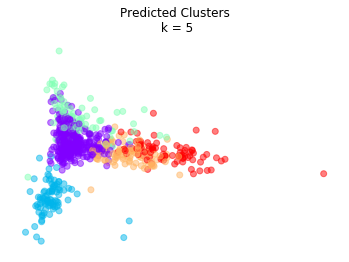

In [29]:
fig = plt.figure(1)
ax = fig.add_subplot(111)
ax.set_frame_on(False)
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], color = colors_p, alpha = 0.5)
plt.xticks(())
plt.yticks(())
plt.title('Predicted Clusters\n k = {}'.format(numCategories))
plt.show()

We then use the silhouette method to determine the optimal number of clusters. The silhouette score is a measure of both cohesion and separation and ranges from -1 to 1 with the score higher being better.

In [ ]:
def plotSilhouette(n_clusters, X):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize = (15,5))
    
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])
    clusterer = sklearn.cluster.KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    
    silhouette_avg = sklearn.metrics.silhouette_score(X, cluster_labels)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = sklearn.metrics.silhouette_samples(X, cluster_labels)

    y_lower = 10
    
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        cmap = matplotlib.cm.get_cmap("nipy_spectral")
        color = cmap(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        y_lower = y_upper + 10
    
    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    cmap = matplotlib.cm.get_cmap("nipy_spectral")
    colors = cmap(float(i) / n_clusters)
    ax2.scatter(reduced_data[:, 0], reduced_data[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors)

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    projected_centers = pca.transform(centers)
    # Draw white circles at cluster centers
    ax2.scatter(projected_centers[:, 0], projected_centers[:, 1],
                marker='o', c="white", alpha=1, s=200)

    for i, c in enumerate(projected_centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50)

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("PC 1")
    ax2.set_ylabel("PC 2")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.show()
    print("For n_clusters = {}, The average silhouette_score is : {:.3f}".format(n_clusters, silhouette_avg))

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


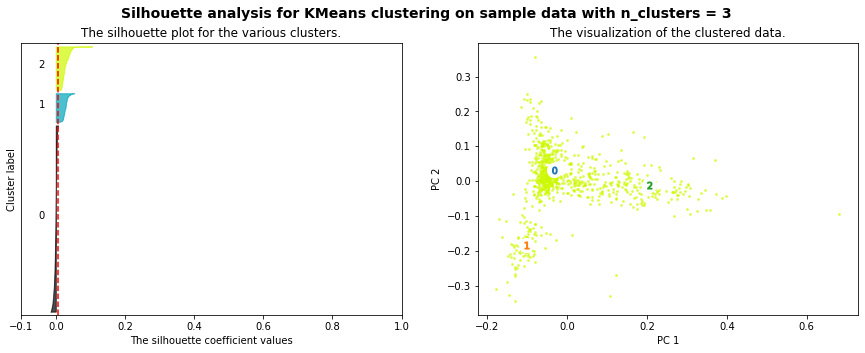

For n_clusters = 3, The average silhouette_score is : 0.007


In [26]:
X = netTFVects.toarray()
plotSilhouette(3, X)

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


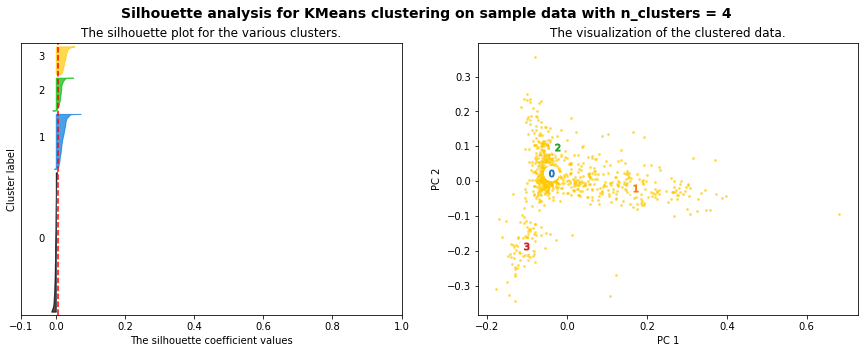

For n_clusters = 4, The average silhouette_score is : 0.008


In [27]:
X = netTFVects.toarray()
plotSilhouette(4, X)

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


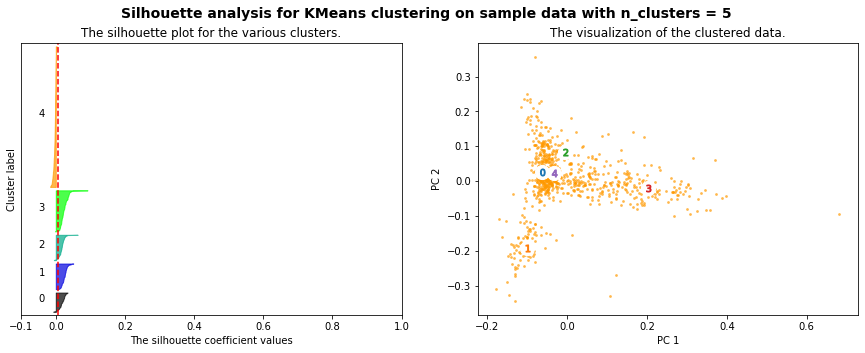

For n_clusters = 5, The average silhouette_score is : 0.008


In [28]:
X = netTFVects.toarray()
plotSilhouette(5, X)

We can see very similar results, with scores being .007, .008 and .008 for K = 3, 4, 5 respectively. The silhouette method indicates that we should have 4 or 5 clusters instead of 3. 

Now, let’s take a look at the top terms for each cluster. For cluster 1 and 2, we can clearly speculate they are documentary and stand-up comedy, and we can kind of guess cluster 0 to be drama.

In [72]:
terms = TFVectorizer.get_feature_names()
print("Top terms per cluster:")
order_centroids = netKM.cluster_centers_.argsort()[:, ::-1]
for i in range(3):
    print("Cluster %d:" % i)
    for ind in order_centroids[i, :10]:
        print(' %s' % terms[ind])
    print('\n')

Top terms per cluster:
Cluster 0:
 life
 young
 man
 family
 comedian
 new
 woman
 world
 comic
 film


Cluster 1:
 documentary
 follows
 explores
 examines
 american
 world
 chronicles
 family
 high
 people


Cluster 2:
 stand
 special
 comedy
 comedian
 comic
 life
 jokes
 takes
 delivers
 shares




We can visualize the true classes as well.

In [73]:
components = netPCA.components_
keyword_ids = list(set(order_centroids[:,:10].flatten())) #Get the ids of the most distinguishing words(features) from your kmeans model.
words = [terms[i] for i in keyword_ids]#Turn the ids into words.
x = components[:,keyword_ids][0,:] #Find the coordinates of those words in your biplot.
y = components[:,keyword_ids][1,:]

In [74]:
colordict = {
'Stand-Up Comedy': 'red',
'Documentaries': 'orange',
'Dramas, International Movies': 'green',
    }
colors = [colordict[c] for c in netflix_3['listed_in']]
print("The categories' colors are:\n{}".format(colordict.items()))

The categories' colors are:
dict_items([('Stand-Up Comedy', 'red'), ('Documentaries', 'orange'), ('Dramas, International Movies', 'green')])


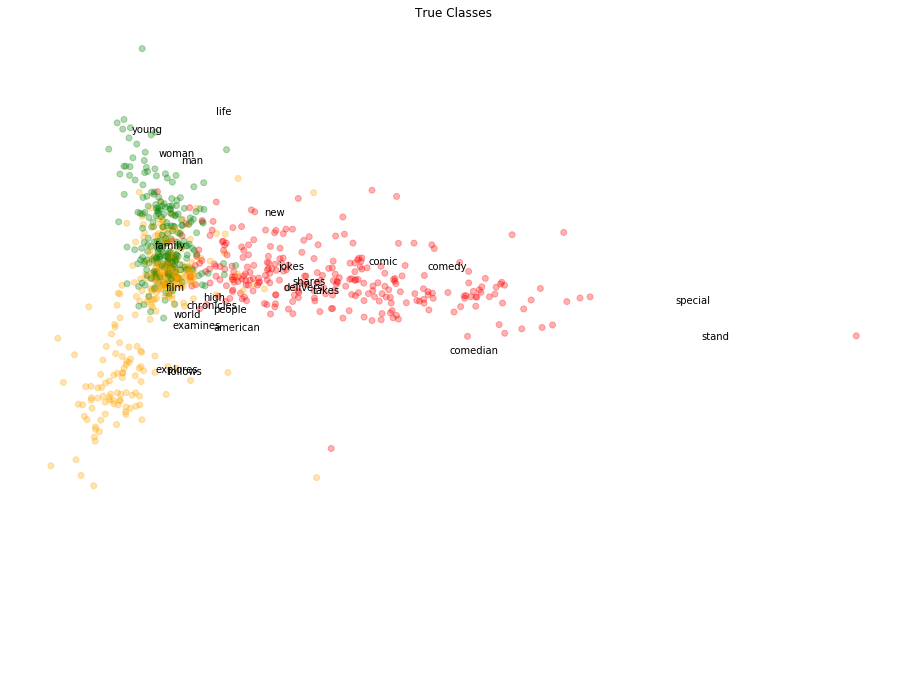

In [75]:
fig = plt.figure(figsize = (16,9))
ax = fig.add_subplot(111)
ax.set_frame_on(False)
ax.scatter(reducedPCA_data[:, 0], reducedPCA_data[:, 1], color = colors, alpha = 0.3, label = colors)
for i, word in enumerate(words):
    ax.annotate(word, (x[i],y[i]))
plt.xticks(())
plt.yticks(())
plt.title('True Classes')
plt.show()

In [76]:
netflixCategories = ['Dramas, International Movies', 'Stand-Up Comedy', 'Documentaries']
colors_p = [colordict[netflixCategories[l]] for l in netKM.labels_]

We can check whether a k=3 clustering looks similar to the true classes.

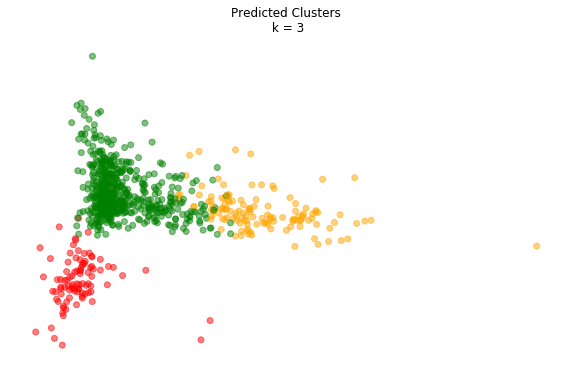

In [77]:
fig = plt.figure(figsize = (10,6))
ax = fig.add_subplot(111)
ax.set_frame_on(False)
plt.scatter(reducedPCA_data[:, 0], reducedPCA_data[:, 1], color = colors_p, alpha = 0.5)
plt.xticks(())
plt.yticks(())
plt.title('Predicted Clusters\n k = 3')
plt.show()

In [78]:
print("For our clusters:")
print("Homogeneity: {:0.3f}".format(sklearn.metrics.homogeneity_score(netflix_3['listed_in'], netKM.labels_)))
print("Completeness: {:0.3f}".format(sklearn.metrics.completeness_score(netflix_3['listed_in'], netKM.labels_)))
print("V-measure: {:0.3f}".format(sklearn.metrics.v_measure_score(netflix_3['listed_in'], netKM.labels_)))
print("Adjusted Rand Score: {:0.3f}".format(sklearn.metrics.adjusted_rand_score(netflix_3['listed_in'], netKM.labels_)))

For our clusters:
Homogeneity: 0.272
Completeness: 0.389
V-measure: 0.320
Adjusted Rand Score: 0.120


# Hierarchical Clustering

### Now we turn to hierarchical clustering, which gives nested clusters at any resolution. 

In [32]:
netCoocMat = netTFVects * netTFVects.T
#set the diagonal to 0 since we don't care how similar texts are to themselves
netCoocMat.setdiag(0)
#Another way of relating the texts is with their cosine similarity
netCosinMat1 = 1 - sklearn.metrics.pairwise.cosine_similarity(netTFVects)
#But generally word occurrence is more accurate


In [31]:
netflix_3['listed_in'][:40].value_counts()

Stand-Up Comedy                 18
Documentaries                   15
Dramas, International Movies     7
Name: listed_in, dtype: int64

In [37]:
selectIndices = []
indexToCat = []
for c in set(netflix_3['listed_in']):
    selectIndices += list(netflix_3[netflix_3['listed_in'] == c].index)[:40]
    indexToCat += [c] * 40

In [38]:
subCoocMat = netCoocMat[selectIndices,:][:,selectIndices]

In [98]:
linkage_matrix = scipy.cluster.hierarchy.ward(subCoocMat.toarray())
linkage_matrix[:10]

array([[8.70000000e+01, 9.00000000e+01, 1.15516472e-01, 2.00000000e+00],
       [1.07000000e+02, 1.20000000e+02, 2.26988943e-01, 3.00000000e+00],
       [1.05000000e+02, 1.06000000e+02, 2.43712994e-01, 2.00000000e+00],
       [6.50000000e+01, 1.21000000e+02, 2.54648259e-01, 4.00000000e+00],
       [8.00000000e+00, 1.23000000e+02, 2.76944739e-01, 5.00000000e+00],
       [3.10000000e+01, 3.30000000e+01, 2.89461729e-01, 2.00000000e+00],
       [4.20000000e+01, 1.24000000e+02, 2.98903845e-01, 6.00000000e+00],
       [1.60000000e+01, 4.80000000e+01, 3.04571204e-01, 2.00000000e+00],
       [3.40000000e+01, 7.00000000e+01, 3.17540009e-01, 2.00000000e+00],
       [4.30000000e+01, 7.70000000e+01, 3.21098905e-01, 2.00000000e+00]])

The graph visualizes the dendrogram of 40 Netflix movies per category and the bottom one restricts the number of visible branches.

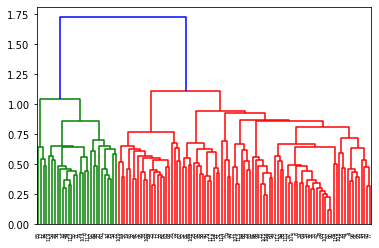

In [99]:
dendDat = scipy.cluster.hierarchy.dendrogram(linkage_matrix, get_leaves=True)

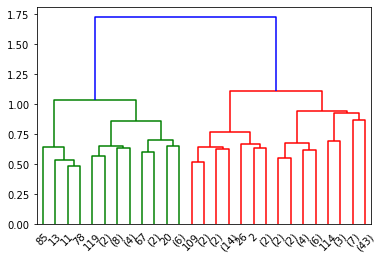

In [100]:
dendrogramDat = scipy.cluster.hierarchy.dendrogram(linkage_matrix, p=4, truncate_mode='level', get_leaves=True)

In [101]:
hierarchicalClusters = scipy.cluster.hierarchy.fcluster(linkage_matrix, 4, 'maxclust')
hierarchicalClusters

array([2, 2, 3, 4, 4, 4, 4, 2, 4, 4, 2, 1, 3, 1, 4, 4, 2, 4, 4, 3, 2, 4,
       3, 4, 2, 3, 3, 3, 4, 4, 4, 4, 3, 4, 4, 3, 4, 4, 3, 4, 4, 3, 4, 4,
       4, 3, 4, 4, 2, 4, 4, 4, 4, 3, 2, 2, 2, 3, 4, 2, 2, 4, 3, 3, 4, 4,
       4, 2, 3, 4, 4, 2, 2, 3, 2, 2, 2, 4, 1, 4, 2, 4, 3, 4, 4, 1, 4, 4,
       4, 3, 4, 4, 4, 4, 4, 3, 4, 4, 2, 4, 3, 4, 4, 2, 4, 4, 4, 4, 4, 3,
       4, 4, 2, 2, 4, 4, 4, 4, 4, 2], dtype=int32)

The key metrics of hierarchical clustering look better than the flat clustering. There could be several reasons for that. Knowing that the genre drama has an eclectic mix of movies, it probably needs more complex clustering than a flat one.

In [102]:
linkage_matrix_full = scipy.cluster.hierarchy.ward(netCoocMat.toarray())
hierarchicalClusters_full = scipy.cluster.hierarchy.fcluster(linkage_matrix_full, 4, 'maxclust')
print("For our complete clusters:")
print("Homogeneity: {:0.3f}".format(sklearn.metrics.homogeneity_score(netflix_3['listed_in'], hierarchicalClusters_full)))
print("Completeness: {:0.3f}".format(sklearn.metrics.completeness_score(netflix_3['listed_in'], hierarchicalClusters_full)))
print("V-measure: {:0.3f}".format(sklearn.metrics.v_measure_score(netflix_3['listed_in'], hierarchicalClusters_full)))
print("Adjusted Rand Score: {:0.3f}".format(sklearn.metrics.adjusted_rand_score(netflix_3['listed_in'], hierarchicalClusters_full)))

For our complete clusters:
Homogeneity: 0.397
Completeness: 0.423
V-measure: 0.409
Adjusted Rand Score: 0.261


In [103]:
netflix_3['wald_predictions'] = hierarchicalClusters_full
netflix_3

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,kmeans_predictions,wald_predictions
1,80117401,Movie,Jandino: Whatever it Takes,NaN,Jandino Asporaat,United Kingdom,"September 9, 2016",2016,TV-MA,94 min,Stand-Up Comedy,Jandino Asporaat riffs on the challenges of ra...,0,2
7,80164077,Movie,Fabrizio Copano: Solo pienso en mi,"Rodrigo Toro, Francisco Schultz",Fabrizio Copano,Chile,"September 8, 2017",2017,TV-MA,60 min,Stand-Up Comedy,Fabrizio Copano takes audience participation t...,2,1
10,80169755,Movie,Joaquín Reyes: Una y no más,José Miguel Contreras,Joaquín Reyes,NaN,"September 8, 2017",2017,TV-MA,78 min,Stand-Up Comedy,Comedian and celebrity impersonator Joaquín Re...,0,2
22,80046727,Movie,Rolling Papers,Mitch Dickman,NaN,"United States, Uruguay","September 8, 2017",2015,TV-MA,79 min,Documentaries,"As the newspaper industry takes a hit, The Den...",0,4
27,80203094,Movie,City of Joy,Madeleine Gavin,NaN,"United States,","September 7, 2018",2018,TV-MA,77 min,Documentaries,Women who've been sexually brutalized in war-t...,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5571,80100054,Movie,Skins,Eduardo Casanova,"Ana Polvorosa, Candela Peña, Macarena Gómez, C...",Spain,"April 1, 2017",2017,TV-MA,78 min,"Dramas, International Movies","Deformed, disfigured characters must find a wa...",0,4
5572,80097468,Movie,The Bad Kids,"Keith Fulton, Louis Pepe",NaN,United States,"April 1, 2017",2016,TV-MA,101 min,Documentaries,"In this documentary, teachers at a Mojave Dese...",1,3
5574,80104237,Movie,The Tenth Man,Daniel Burman,"Alan Sabbagh, Julieta Zylberberg, Usher Barilk...",Argentina,"April 1, 2017",2016,TV-MA,81 min,"Dramas, International Movies",After spending much of his adult life in New Y...,0,4
5577,80085438,Movie,Frank and Cindy,G.J. Echternkamp,NaN,United States,"April 1, 2016",2007,TV-MA,70 min,Documentaries,Frank was a rising pop star when he married Ci...,0,4


# Gensim


### Next, let’s take a look at topic modeling using the gensim package. This method is based on LDA. We can start with 3 topics. 

In [39]:
#Apply our functions
netflix_3['tokenized_text'] = netflix_3['description'].apply(lambda x: lucem_illud_2020.word_tokenize(x))
netflix_3['normalized_tokens'] = netflix_3['tokenized_text'].apply(lambda x: lucem_illud_2020.normalizeTokens(x))

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [43]:
netflix_3['reduced_tokens'] = netflix_3['normalized_tokens'].apply(lambda x: dropMissing(x, TFVectorizer.vocabulary_.keys()))

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [47]:
dictionary = gensim.corpora.Dictionary(netflix_3['reduced_tokens'])

In [48]:
corpus = [dictionary.doc2bow(text) for text in netflix_3['reduced_tokens']]

In [49]:
gensim.corpora.MmCorpus.serialize('netflix.mm', corpus)
netmm = gensim.corpora.MmCorpus('netflix.mm')

In [60]:
netlda = gensim.models.ldamodel.LdaModel(corpus=netmm, id2word=dictionary, num_topics=3, alpha='auto', eta='auto')

In [61]:
netflix_3 = netflix_3.reset_index()

In [62]:
net1Bow = dictionary.doc2bow(netflix_3['reduced_tokens'][5])
net1lda = netlda[net1Bow]
print("The topics of the text: {}".format(netflix_3['title'][5]))
print("are: {}".format(net1lda))

The topics of the text: Elstree 1976
are: [(0, 0.034659646), (1, 0.93411213), (2, 0.031228228)]


In [63]:
ldaDF = pandas.DataFrame({
        'title' : netflix_3['title'],
        'topics' : [netlda[dictionary.doc2bow(l)] for l in netflix_3['reduced_tokens']]
    })

In [64]:
#Dict to temporally hold the probabilities
topicsProbDict = {i : [0] * len(ldaDF) for i in range(netlda.num_topics)}

#Load them into the dict
for index, topicTuples in enumerate(ldaDF['topics']):
    for topicNum, prob in topicTuples:
        topicsProbDict[topicNum][index] = prob

#Update the DataFrame
for topicNum in range(netlda.num_topics):
    ldaDF['topic_{}'.format(topicNum)] = topicsProbDict[topicNum]

ldaDF[1::100]

,title,topics,topic_0,topic_1,topic_2
1,Fabrizio Copano: Solo pienso en mi,"[(0, 0.9160767), (1, 0.043523155), (2, 0.04040...",0.916077,0.043523,0.040400
101,Aashayein,"[(0, 0.045086633), (1, 0.9075074), (2, 0.04740...",0.045087,0.907507,0.047406
201,Bill Burr: Let It Go,"[(0, 0.037018336), (1, 0.0400955), (2, 0.92288...",0.037018,0.040096,0.922886
301,Layla M.,"[(0, 0.04084463), (1, 0.042302255), (2, 0.9168...",0.040845,0.042302,0.916853
401,Devil's Bride,"[(0, 0.0386684), (1, 0.8294775), (2, 0.13185412)]",0.038668,0.829477,0.131854
501,Mitt,"[(0, 0.6020837), (1, 0.34641847), (2, 0.051497...",0.602084,0.346418,0.051498
601,42 Grams,"[(0, 0.038373623), (1, 0.04326555), (2, 0.9183...",0.038374,0.043266,0.918361
701,May We Chat,"[(0, 0.042693444), (1, 0.59482354), (2, 0.3624...",0.042693,0.594824,0.362483
801,Kevin Hart: What Now?,"[(0, 0.03589316), (1, 0.93413997), (2, 0.02996...",0.035893,0.934140,0.029967


In [67]:
ldaDFV = ldaDF[:10][['topic_%d' %x for x in range(3)]]
ldaDFVisN = ldaDF[:10][['title']]
ldaDFVis = ldaDFV.as_matrix(columns=None)
ldaDFVisNames = ldaDFVisN.as_matrix(columns=None)
ldaDFV

,topic_0,topic_1,topic_2
0,0.868578,0.070296,0.061127
1,0.916077,0.043523,0.040400
2,0.046737,0.910749,0.042514
3,0.053611,0.896365,0.050025
4,0.921732,0.041681,0.036587
5,0.034640,0.934132,0.031228
6,0.097701,0.827356,0.074943
7,0.038887,0.400498,0.560615
8,0.035818,0.041257,0.922925
9,0.052067,0.485879,0.462053


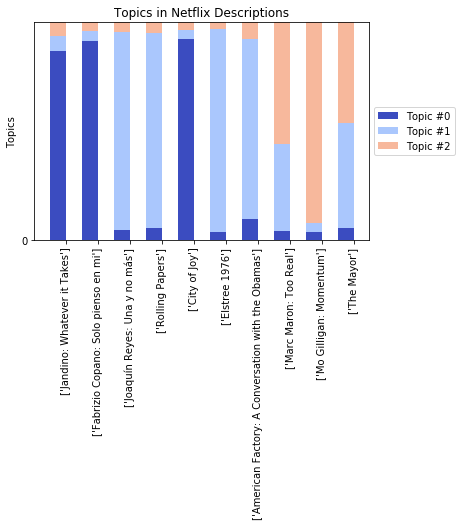

In [69]:
N = 10
ind = np.arange(N)
K = netlda.num_topics  # N documents, K topics
ind = np.arange(N)  # the x-axis locations for the novels
width = 0.5  # the width of the bars
plots = []
height_cumulative = np.zeros(N)

for k in range(K):
    color = plt.cm.coolwarm(k/K, 1)
    if k == 0:
        p = plt.bar(ind, ldaDFVis[:, k], width, color=color)
    else:
        p = plt.bar(ind, ldaDFVis[:, k], width, bottom=height_cumulative, color=color)
    height_cumulative += ldaDFVis[:, k]
    plots.append(p)
    

plt.ylim((0, 1))  # proportions sum to 1, so the height of the stacked bars is 1
plt.ylabel('Topics')

plt.title('Topics in Netflix Descriptions')
plt.xticks(ind+width/2, ldaDFVisNames, rotation='vertical')

plt.yticks(np.arange(0, 1, 3))
topic_labels = ['Topic #{}'.format(k) for k in range(K)]
plt.legend([p[0] for p in plots], topic_labels, loc='center left', frameon=True,  bbox_to_anchor = (1, .5))

plt.show()

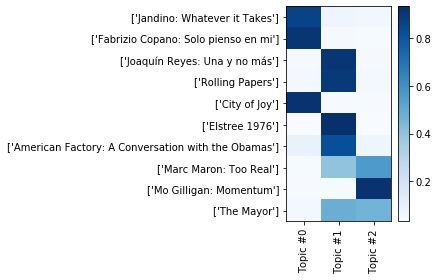

In [70]:
plt.pcolor(ldaDFVis, norm=None, cmap='Blues')
plt.yticks(np.arange(ldaDFVis.shape[0])+0.5, ldaDFVisNames);
plt.xticks(np.arange(ldaDFVis.shape[1])+0.5, topic_labels);

# flip the y-axis so the texts are in the order we anticipate (Austen first, then Brontë)
plt.gca().invert_yaxis()

# rotate the ticks on the x-axis
plt.xticks(rotation=90)

# add a legend
plt.colorbar(cmap='Blues')
plt.tight_layout()  # fixes margins
plt.show()

In [71]:
netlda.show_topic(1)

[('stand', 0.022022098),
 ('special', 0.01953037),
 ('comedian', 0.01722617),
 ('documentary', 0.016292034),
 ('life', 0.0155322645),
 ('comic', 0.013807902),
 ('woman', 0.013180945),
 ('comedy', 0.010420581),
 ('share', 0.009978689),
 ('new', 0.009673934)]

We can see that the results are quite similar to flat clustering. And notice that there are still a lot of overlapped words, suggesting they have high co-occurrence rates.

In [72]:
topicsDict = {}
for topicNum in range(netlda.num_topics):
    topicWords = [w for w, p in netlda.show_topic(topicNum)]
    topicsDict['Topic_{}'.format(topicNum)] = topicWords

wordRanksDF = pandas.DataFrame(topicsDict)
wordRanksDF

,Topic_0,Topic_1,Topic_2
0,documentary,stand,stand
1,life,special,live
2,stand,comedian,life
3,comedian,documentary,comedian
4,film,life,man
5,explore,comic,special
6,young,woman,comic
7,family,comedy,world
8,live,share,family
9,special,new,lead


<Figure size 432x288 with 0 Axes>

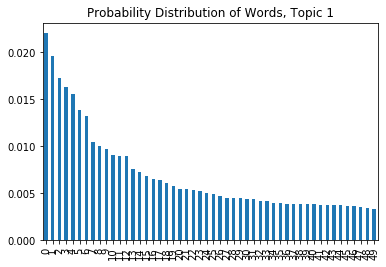

In [73]:
topic1_df = pandas.DataFrame(netlda.show_topic(1, topn=50))
plt.figure()
topic1_df.plot.bar(legend = False)
plt.title('Probability Distribution of Words, Topic 1')
plt.show()

One of the important aspects of topic modeling is hyperparameter tuning, which specifies the sparsity of document-word loadings and topic-word loadings. Since a document can have multiple topics and words can belong to multiple topics, we can tune the hyperparameters as we want to.

Using 10 topics and differetn $\eta$s, we see the distribution of words being very different.

In [74]:
netlda1 = gensim.models.ldamodel.LdaModel(corpus=netmm, id2word=dictionary, num_topics=10, eta = 0.00001)
netlda2 = gensim.models.ldamodel.LdaModel(corpus=netmm, id2word=dictionary, num_topics=10, eta = 0.9)

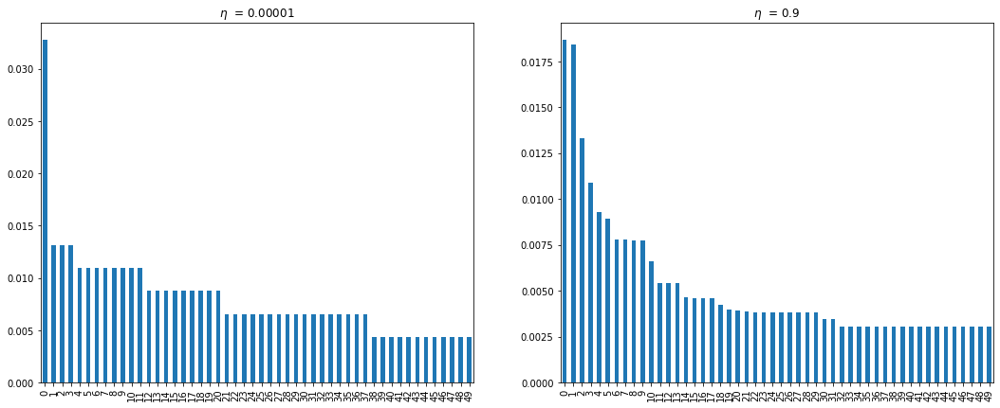

In [75]:
topic11_df = pandas.DataFrame(netlda1.show_topic(1, topn=50))
topic21_df = pandas.DataFrame(netlda2.show_topic(1, topn=50))

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
topic11_df.plot.bar(legend = False, ax = ax1, title = '$\eta$  = 0.00001')
topic21_df.plot.bar(legend = False, ax = ax2, title = '$\eta$  = 0.9')
plt.show()

# Network

### Lastly, topic modeling can lead to more complex analysis such as networks. Here I extracted the script of a movie, because movie scripts give character interactions, hence the networks.

In [176]:
corpora_address = "/Users/harryx113/Downloads/Movies 2"

In [177]:
movie_texts = lucem_illud_2020.loadDavies(corpora_address, num_files=2000)

text_13_idi.zip
text_16_qll.zip
text_32_ldf.zip
text_19_gvc.zip
text_05_nko.zip
text_17_arp.zip
text_01_ote.zip
text_28_rfy.zip
text_31_akv.zip
text_22_etp.zip
text_11_uoy.zip
text_09_oii.zip
text_06_jfy.zip
text_14_lnc.zip
text_08_loh.zip
text_33_kje.zip
text_30_wkp.zip
text_07_oma.zip
text_03_mnq.zip
text_21_fqa.zip
text_29_oye.zip
text_27_fle.zip
text_23_fmh.zip
text_12_rcq.zip
text_00_myn.zip
text_10_aoy.zip
text_04_mlq.zip
text_20_cde.zip
text_02_mqu.zip
text_26_ngj.zip
text_24_ywo.zip
text_18_jfj.zip
text_25_byg.zip
text_15_guo.zip


In [178]:
zfile = zipfile.ZipFile(corpora_address + "/sources_movies.zip")
source = []

In [179]:
for file in zfile.namelist():
    with zfile.open(file) as f:
        for line in f:
            source.append(line)

In [229]:
movie_dict = {}

In [230]:
for movie in source[3:]:
    try:
        textID, fileID, wordcount, genre, year, country, language, imbd, movie = movie.decode("utf-8").split("\t")
    except UnicodeDecodeError:
        continue
   # if movie.strip() not in movie_dict:
   #     movie_dict[movie.strip()] = []
    if fileID.strip() in movie_texts:
        try:
            movie_dict[movie.strip()]=[(movie_texts[fileID.strip()])]
        except KeyError:
            continue

In [231]:
movie_dict

{'Animal Crackers': [['You',
   'must',
   'do',
   'your',
   'best',
   'tonight',
   'Be',
   'on',
   'your',
   'toes',
   'men',
   'There',
   "'s",
   'another',
   'guest',
   'tonight',
   'It',
   "'s",
   'one',
   'of',
   'those',
   'men',
   'Who',
   'are',
   'being',
   'feted',
   'by',
   'the',
   'smart',
   'set',
   'We',
   "'ll",
   'see',
   'that',
   'he',
   'gets',
   'what',
   'he',
   'deserves',
   'Treat',
   'him',
   'as',
   'they',
   'do',
   'a',
   'king',
   'in',
   'manner',
   'royal',
   'Like',
   'a',
   'subject',
   'to',
   'a',
   'king',
   'you',
   'must',
   'be',
   'loyal',
   'On',
   'this',
   'object',
   'you',
   'must',
   'have',
   'your',
   'heart',
   'set',
   'We',
   "'ll",
   'do',
   'nothing',
   'to',
   'get',
   'on',
   'his',
   'nerves',
   'Again',
   'I',
   'mention',
   'Be',
   'on',
   'your',
   'toes',
   'men',
   'He',
   'craves',
   'attention',
   'He',
   "'s",
   'one',
   'of',
   'thos

In [232]:
movie_df = pd.DataFrame(columns=["Movie Title", "Tokenized Texts"])

In [233]:
i = 0
for movie in movie_dict:
    # since there were multiple lists
    # print(movie)
    full_script = []
    for part in movie_dict[movie]:
        full_script = full_script + part
    movie_df.loc[i] = [movie, full_script]
    i += 1

In [235]:
movie_df

,Movie Title,Tokenized Texts
0,Animal Crackers,"[You, must, do, your, best, tonight, Be, on, y..."
1,Anna Christie,"[Either, you, 're, flat, or, I, am, I, beg, yo..."
2,Ladies of Leisure,"[Look, out, There, 's, another, bottle, coming..."
3,Min and Bill,"[All, right, Pack, her, up, there, Hey, Sandy,..."
4,The Office Wife,"[18th, Floor, Fellowes, Publishing, Company, W..."
...,...,...
2315,VooDoo,"[Oh, g, why, No, Frank, Higher, higher, mommy,..."
2316,Western World,"[I, 'll, see, you, ladies, later, Now, when, I..."
2317,Losing Sight of Shore,"[Natalia_whispering, Can, you, hear, the, sile..."
2318,Smurfs: The Lost Village,"[This, story, begins, in, a, secret, place, hi..."


The Marine 5: Battleground is selected because it has clear indicators for lines by each character.

In [253]:
btl = movie_df['Tokenized Texts'][2309]
movie_df[-20:]

,Movie Title,Tokenized Texts
2300,Imagine Dragons: Believer,"[First, things, first, I, 'm, a, say, all, The..."
2301,Lucas Brothers: On Drugs,"[America, 's, public, enemy, number, one, in, ..."
2302,Maria Bamford: Old Baby,"[I, always, like, to, tell, audiences, pre, pr..."
2303,Needlestick,"[Everett, Hey, hey, ooh, cookies, Thanks, Than..."
2304,Rough Night,"[31;7436;TOOLONG, Woman, you, know, you, 're, ..."
2305,Secrets of Deception,"[What, 's, up, Well, I, have, a, client, with,..."
2306,Stalker's Prey,"[Laura, Laura, Chloe, Are, you, sure, about, o..."
2307,The Horse Dancer,"[@music_playing, And, you, are, you, are, fore..."
2308,The Jetsons & WWE: Robo-WrestleMania!,"[@rock_music_playing, CHATTERING, EXCLAIMING, ..."
2309,The Marine 5: Battleground,"[@rock_music_playing, @engine_revving, Slipped..."


In [254]:
' '.join(btl[0:1500])

"@rock_music_playing @engine_revving Slipped through the cracks Down to the floor This is the reason Honey I 'm calling for more Shot into space You 're like a ghost in the dark I do n't think so Baby forevermore I got the place If you got the time Set em up in the streets now And knock em all down Like an eraser I 'm rubbing hard I play for keeps now honey I 'm not getting out Oh I got the noose If you got the heart Taking you downtown honey Back to the start Oh I got the noose You got the heart Taking you downtown honey Oh I got the noose You got the heart Taking you downtown honey Oh I got the noose You got EXHALES @indistinct_chatter EXHALES Keep it tight man This will be over soon MOTORCYCLEENGINEREVVING TAYLOR Man that 's not him I owe you 150 bucks So I 'm talking about an extra $ 150 So what more can I get for that @indistinct_chatter Jokers driving wild Some motherfucker 25;6333;TOOLONG Guys What 's up Deacon What up Yeah WOMAN Where you going baby Yo Hey Hey MAN There he is W

Create a list of all important characters.

In [256]:
character_list = ['JAKE', 'ANA', 'DEACON', 'CASH', 'ALONZO', 'MURPHY', 'ZOE', 'VINCENT', 'COLE', 'TAYLOR', 'RODRIGO', 
              'SERGEANT']

In [258]:
characters = {}
for token in btl:
    if token in character_list:
        
        if token not in characters:
            characters[token] = 0
        if token in characters:
            characters[token] += 1

In [259]:
characters

{'TAYLOR': 1,
 'VINCENT': 10,
 'COLE': 7,
 'ZOE': 13,
 'SERGEANT': 1,
 'JAKE': 22,
 'ALONZO': 13,
 'DEACON': 7,
 'CASH': 5}

In [260]:
btl_actor_network = nx.Graph()

In [261]:
for character in characters:
        btl_actor_network.add_node(character, lines_spoken= characters[character], words=[])

In [286]:
i = 0
all_texts = []
for token in btl:
    i += 1
    if i > len(btl):
        break
    
    if token in btl_actor_network.nodes():
        j = i
        for token_ in btl[i:]:
            if token_ in btl_actor_network.nodes():
                # if both the characters exist in the graph, add a weight
                if token_ != token:
                    if (token, token_) not in btl_actor_network.edges():
                        btl_actor_network.add_edge(token, token_, weight=0)
                    if (token, token_) in btl_actor_network.edges():
                        btl_actor_network.edges[(token, token_)]['weight'] += 1
                break
            j += 1
        # adding characters sentences
        btl_actor_network.nodes[token]['words'].append(btl[i:j])
        all_texts.append(lucem_illud_2020.normalizeTokens(btl[i:j]))

We can see from the network graph, Vincent and Jake sit at the center of the web, as they are the leading roles. 

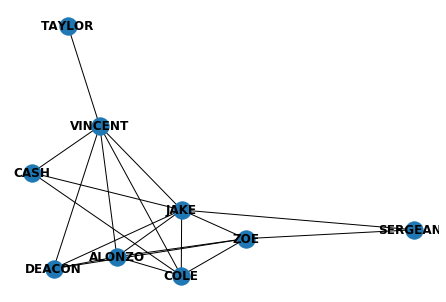

In [287]:
nx.draw(btl_actor_network, with_labels=True, font_weight='bold')

In [288]:
all_texts[0:10]

[['man',
  'owe',
  'buck',
  'be',
  'talk',
  'extra',
  '$',
  '@indistinct_chatter',
  'joker',
  'drive',
  'wild',
  'motherfucker',
  '25;6333;toolong',
  'guy',
  'deacon',
  'yes',
  'woman',
  'go',
  'baby',
  'yo',
  'hey',
  'hey',
  'man',
  'woman',
  'tonight',
  'come',
  'alonzo',
  'baby',
  'whoo',
  'hey',
  'prospect',
  'boo',
  'rodrigo'],
 ['way',
  'have',
  'vice',
  'president',
  'business',
  'bar',
  'come',
  'baby',
  'have',
  'right',
  'little',
  'brother',
  'damn',
  'right',
  'legion',
  'yes',
  'let',
  'let',
  'menclamoring'],
 ['shit',
  'come',
  'come',
  'man',
  'man',
  'let',
  '@tires_squealing',
  'groan',
  'groaninginpain',
  'man',
  'go',
  'gun',
  'man',
  'stack',
  '@engine_revving',
  'avenge',
  'promise',
  'enginesrevving',
  '@sirens_wailing',
  'get',
  'female',
  'crane',
  'lift',
  'brick',
  'roof',
  'asshole',
  'overload',
  'chain',
  'break',
  'half',
  'load',
  'land',
  'car',
  'conscious',
  'trap',
  '

In [289]:
dictionary = gensim.corpora.Dictionary(all_texts)

In [290]:
corpus = [dictionary.doc2bow(text) for text in all_texts]

In [292]:
gensim.corpora.MmCorpus.serialize('btl.mm', corpus)
btlcorpus = gensim.corpora.MmCorpus('btl.mm')

In [335]:
btllda = gensim.models.ldamodel.LdaModel(corpus=btlcorpus, id2word=dictionary, num_topics=3, alpha='auto', eta='auto')

In [336]:
btllda.show_topics()

[(0,
  '0.037*"come" + 0.025*"man" + 0.019*"get" + 0.017*"na" + 0.016*"yes" + 0.014*"gon" + 0.013*"be" + 0.013*"let" + 0.012*"hey" + 0.012*"right"'),
 (1,
  '0.017*"na" + 0.016*"get" + 0.014*"hey" + 0.014*"be" + 0.013*"have" + 0.013*"come" + 0.011*"fuck" + 0.010*"kill" + 0.009*"know" + 0.009*"gon"'),
 (2,
  '0.028*"get" + 0.018*"okay" + 0.017*"come" + 0.013*"be" + 0.011*"whoa" + 0.011*"look" + 0.010*"na" + 0.010*"gon" + 0.010*"guy" + 0.009*"truck"')]

In [337]:
for actor in btl_actor_network.nodes():
    actor_all_words = []
    for sent in btl_actor_network.nodes[actor]['words']:
        for word in sent:
            actor_all_words += word
    btl_actor_network.nodes[actor]['topic_distribution'] = btllda[dictionary.doc2bow(lucem_illud_2020.normalizeTokens(actor_all_words))]

In [338]:
for actor in btl_actor_network.nodes():
    print(actor, btl_actor_network.nodes[actor]['topic_distribution'])

TAYLOR [(0, 0.67621934), (2, 0.3197875)]
VINCENT [(0, 0.5282672), (2, 0.4713614)]
COLE [(0, 0.4976599), (2, 0.5020445)]
ZOE [(0, 0.49154183), (2, 0.5077267)]
SERGEANT [(0, 0.5878507), (2, 0.40651217)]
JAKE [(0, 0.54114354), (2, 0.45863137)]
ALONZO [(0, 0.59331185), (2, 0.40631095)]
DEACON [(0, 0.52521515), (2, 0.47421676)]
CASH [(0, 0.541835), (2, 0.45581627)]


In [339]:
L = []
for actor_1 in btl_actor_network.nodes():
    p = btl_actor_network.nodes[actor_1]['topic_distribution'] 
    p = convert_to_prob(p)
    l = []
    for actor_2 in btl_actor_network.nodes():
        q = btl_actor_network.nodes[actor_2]['topic_distribution'] 
        q = convert_to_prob(q)
        l.append(kullback_leibler(p, q))
    L.append(l)
M = np.array(L)

We can also see from the heatmap that Taylor talks differently from almost everyone else, because he’s the only one that died from the movie. 

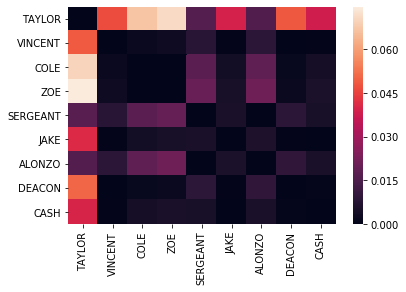

In [342]:
fig = plt.figure()
div = pandas.DataFrame(M, columns = list(btl_actor_network.nodes()), index = list(btl_actor_network.nodes()))
ax = sns.heatmap(div)
plt.show()